In [2]:
colors = {
    "p53": "#008DD5",
    "nutlin": "#DB5461",
    "nfkb": "#C33149",
    "tnf": "#107E7D",
    "gray": "#DAE0DC"
}

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from scipy.signal import find_peaks
from tqdm import tqdm
import pickle
import gzip

In [4]:
# defining parameters from Krishna/Jensen

k_Nin = 5.4 # min^{-1}
k_lin = 0.018 # min^{-1} 
k_t = 1.03 # mu * M^{-1} * min^{-1}
k_tl = 0.24 # min^{-1}
K_I = 0.035 # mu * M
K_N = 0.029 # mu * M
gamma_m = 0.017 # min^{-1}
alpha = 1.05 # mu * M^{-1} * min^{-1}
N_tot = 1.0 # mu * M
k_a = 0.24 # min^{-1}
k_i = 0.18 # min^{-1}
k_p = 0.036 # min^{-1}
k_A20 = 0.0018 # mu * M
IKK_tot = 2.0 # mu * M
A20 = 0.0026 # mu * M


# Mean value for TNF oscillations
k = 0.5

In [5]:
# This is fetched from "nfkappab.ipynb" where we calculated it with constant TNF = 0.5
x0 = [0.038121575605998374, 0.4043266277640023, 4.065919561814218, 0.1799999999999994, 1.5500000000000014]
T_int = 108.47222222222223
A_int = 0.12940028915485896

In [122]:
# defining equations from Krishna/Jensen
def N_n_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dN_ndt = k_Nin * (N_tot - N_n) * K_I / (K_I + I) - k_lin * I * (N_n / (K_N + N_n))
    return dN_ndt

def I_m_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dI_mdt = k_t * (N_n**2) - gamma_m * I_m
    return dI_mdt

def I_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dIdt = k_tl * I_m - alpha * IKK_a * (N_tot - N_n) * I / (K_I + I)
    return dIdt

def IKK_a_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dIKK_adt = k_a * TNF * (IKK_tot - IKK_a - IKK_i) - k_i * IKK_a
    return dIKK_adt

def IKK_i_change(t, N_n, I_m, I, IKK_a, IKK_i, TNF):
    dIKK_idt = k_i * IKK_a - k_p * IKK_i * k_A20 / (k_A20 + A20 * TNF)
    return dIKK_idt

def system_nfkb(t, y, A_ext, T_ext):
    N_n, I_m, I, IKK_a, IKK_i = np.maximum(y, 0)  # Enforce non-negativity
    TNF = np.maximum(k + A_ext * np.sin(2 * np.pi * (1 / T_ext) * t), 0)
    
    return [N_n_change(t, *y, TNF), 
            I_m_change(t, *y, TNF), 
            I_change(t, *y, TNF), 
            IKK_a_change(t, *y, TNF), 
            IKK_i_change(t, *y, TNF)]

In [123]:
def TNF_sin_osc(oscillations, T_internal, A_ext, OOmega = None, T_external = None):
    if (not T_external and OOmega):
        T_external = OOmega * T_internal
    if (not OOmega and T_external):
        OOmega = T_external / T_internal

    history = {"t":[] ,"N_n": [], "I_m": [], "I": [], "IKK_a":[], "IKK_i":[], "TNF":[]}
    
    for i in tqdm(range(oscillations)):
        if i == 0:
            state = x0
        else:
            state = history["N_n"][-1], history["I_m"][-1], history["I"][-1], history["IKK_a"][-1], history["IKK_i"][-1]

        sys = solve_ivp(system_nfkb, (0, T_external), state, args=(A_ext, T_external,), method='LSODA', max_step=0.5, dense_output=True)

        N_n, I_m, I, IKK_a, IKK_i = sys["y"][0], sys["y"][1], sys["y"][2], sys["y"][3], sys["y"][4]

        new_t = np.array(sys["t"]) + (history["t"][-1] if history["t"] else 0)
        history["t"].extend(new_t)
        history["N_n"].extend(N_n)
        history["I_m"].extend(I_m)
        history["I"].extend(I)
        history["IKK_a"].extend(IKK_a)
        history["IKK_i"].extend(IKK_i)
        history["TNF"].extend(k + A_ext * np.sin(2*np.pi * (1 / T_external) * new_t))

    return history, T_external, OOmega

In [124]:
no_osc = 300

# defining omega amplitude, TNF_0 and start parameters as the last values of the first simulation
current_omega = 1
coupling_strength = 1.38947368

TNF_amp = A_int * coupling_strength

TNF_period = current_omega * T_int

In [125]:
print(f"Current TNF amplitude = {TNF_amp}")
print(f"Current TNF period = {TNF_period}")

Current TNF amplitude = 0.17979829596506597
Current TNF period = 108.47222222222223


In [126]:
# simulating system with sinus oscillations
simulation, T_TNF, OOmega = TNF_sin_osc(oscillations = no_osc, T_internal = T_int, A_ext = TNF_amp, OOmega = None, T_external=TNF_period)

100%|██████████| 300/300 [00:01<00:00, 184.95it/s]


In [127]:
# unpacking
t_sim, N_n_sim, I_m_sim, I_sim, IKK_a_sim, IKK_i_sim, TNF_sim = np.array(simulation["t"]), np.array(simulation["N_n"]), np.array(simulation["I_m"]), np.array(simulation["I"]), np.array(simulation["IKK_a"]), np.array(simulation["IKK_i"]), np.array(simulation["TNF"])

In [128]:
print(len(find_peaks(TNF_sim, height=np.mean(TNF_sim))[0]))

300


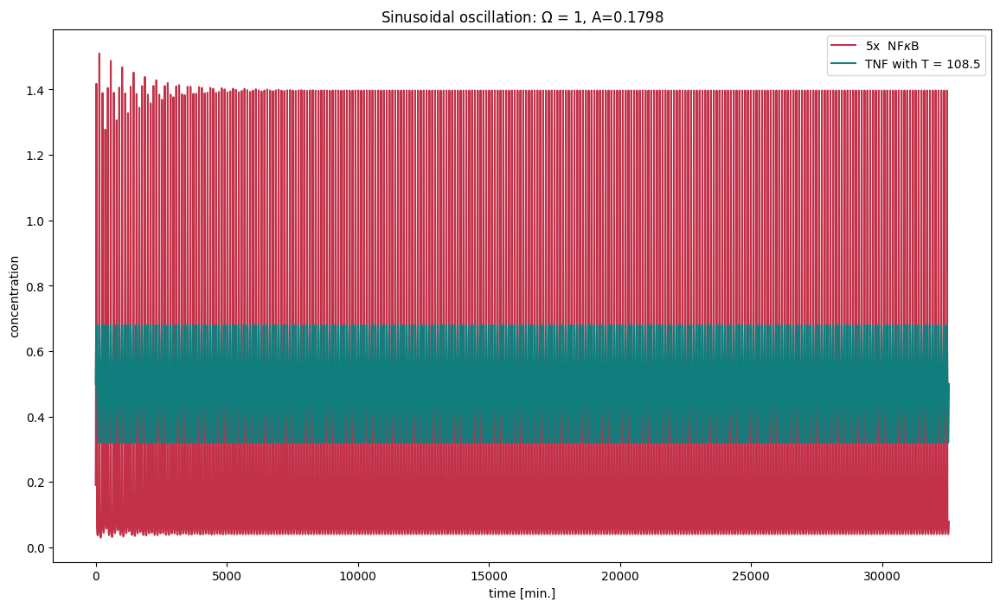

In [129]:
plt.figure(figsize=(14,8))
x = 5
plt.plot(t_sim, x*N_n_sim, color="#C33149", alpha=1, label = f'{x}x  NF$\kappa$B')
plt.plot(t_sim, TNF_sim, alpha=1, color="#107E7D", label = f'TNF with T = {T_TNF:.4}')
plt.title(rf'Sinusoidal oscillation: $\Omega$ = {round(current_omega)}, A={TNF_amp:.4}')
plt.xlabel('time [min.]')
plt.ylabel('concentration')
plt.legend()

___
Ting herfra og ned skal lige køres igen med de nye ligninger

In [130]:
plt.figure(figsize=(14,8))
x = 5
plt.plot(t2[35000:80000], x*N_n2[35000:80000], color="#C33149", label = f'{x}x  NF$\kappa$B')
plt.plot(t2[35000:80000], TNF2[35000:80000], alpha=1, color="#107E7D", label = f'TNF with T = {T_TNF2:.4}')
plt.title(rf'Sinusoidal oscillation: $\Omega$ = {round(omega)}/1, A={Amp1}')
plt.xlabel('time [min.]')
plt.ylabel('concentration')
plt.legend()

NameError: name 't2' is not defined

<Figure size 1400x800 with 0 Axes>

In [131]:
t2[10000]

NameError: name 't2' is not defined

NameError: name 'I_m2' is not defined

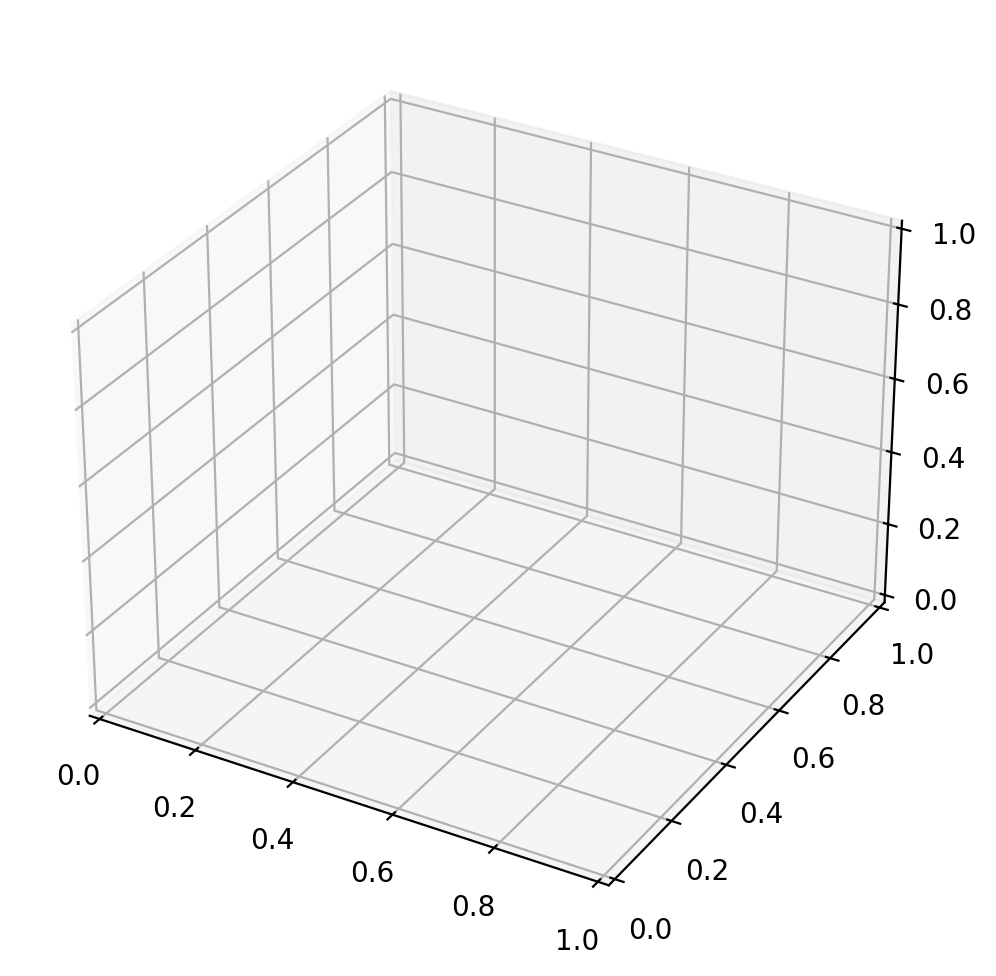

In [132]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax_3d = fig.add_subplot(111, projection='3d')  # Correct index for 3D plot
ax_3d.plot(I_m2[10000:], I2[10000:], N_n2[10000:] * 5, color="#FF0000", alpha=0.8, lw=0.5, label=f'System Trajectory with Omega = {omega}/1, A = {Amp1}')
ax_3d.set_xlabel(r'IkB_m', labelpad=10)
ax_3d.set_ylabel('IkB', labelpad=10)
# Adjust the z-label position
ax_3d.set_zlabel('5x NFkB', labelpad=10)  # Adjust labelpad as needed

# Adjusting the view angle
ax_3d.view_init(elev=20, azim=30)  # Adjust elevation and azimuth to improve visibility

ax_3d.set_title(f'3D Phase Space')
ax_3d.legend()


plt.tight_layout()
plt.title("Simulating the NF-kB network")

#### Saving for liapunov analysis

In [133]:
def save_data(data, filename):
    with gzip.open(filename, 'wb') as f:
        pickle.dump(data, f)

In [134]:
save_data([I_m2, I2, N_n2 * 5], "chaotic_trajectories/nfkb_strange_1.pkl.gz")

NameError: name 'I_m2' is not defined

In [135]:
# why does the amplitude og NFKB keep changing?
def multi_amplitude_plot(A_min, A_max, stepsize):
    
    Amp_arr = np.linspace(A_min, A_max, stepsize)

    all_sims = []

    for i in range(stepsize):
        print("Simulation nr.: ", i)
        TNF_simi, ome, T_TNFi = TNF_sin_osc(oscillations=no_osc, T_internal=T_int, A_ext=Amp_arr[i], OOmega = 1)
        ti, N_ni, I_mi, Ii, IKK_ai, IKK_ii, TNFi = np.array(TNF_simi["t"]), np.array(TNF_simi["N_n"]), np.array(TNF_simi["I_m"]), np.array(TNF_simi["I"]), np.array(TNF_simi["IKK_a"]), np.array(TNF_simi["IKK_i"]), np.array(TNF_simi["TNF"])
        all_sims.append([ti, N_ni, TNFi, I_mi, Ii, IKK_ai, IKK_ii])
    
    return all_sims

In [138]:
A_min = 0
A_max = 0.5
stepsize = 20
Amp_arr = np.linspace(A_min, A_max, stepsize)
print(Amp_arr)

[0.         0.02631579 0.05263158 0.07894737 0.10526316 0.13157895
 0.15789474 0.18421053 0.21052632 0.23684211 0.26315789 0.28947368
 0.31578947 0.34210526 0.36842105 0.39473684 0.42105263 0.44736842
 0.47368421 0.5       ]


In [139]:
sims = multi_amplitude_plot(A_min, A_max, stepsize)

Simulation nr.:  0


100%|██████████| 300/300 [00:01<00:00, 199.88it/s]


Simulation nr.:  1


100%|██████████| 300/300 [00:01<00:00, 179.38it/s]


Simulation nr.:  2


100%|██████████| 300/300 [00:01<00:00, 201.02it/s]


Simulation nr.:  3


100%|██████████| 300/300 [00:01<00:00, 190.68it/s]


Simulation nr.:  4


100%|██████████| 300/300 [00:01<00:00, 188.40it/s]


Simulation nr.:  5


100%|██████████| 300/300 [00:01<00:00, 189.66it/s]


Simulation nr.:  6


100%|██████████| 300/300 [00:01<00:00, 193.26it/s]


Simulation nr.:  7


100%|██████████| 300/300 [00:01<00:00, 188.47it/s]


Simulation nr.:  8


100%|██████████| 300/300 [00:01<00:00, 185.33it/s]


Simulation nr.:  9


100%|██████████| 300/300 [00:01<00:00, 183.39it/s]


Simulation nr.:  10


100%|██████████| 300/300 [00:01<00:00, 194.93it/s]


Simulation nr.:  11


100%|██████████| 300/300 [00:01<00:00, 209.25it/s]


Simulation nr.:  12


100%|██████████| 300/300 [00:01<00:00, 171.86it/s]


Simulation nr.:  13


100%|██████████| 300/300 [00:01<00:00, 172.85it/s]


Simulation nr.:  14


100%|██████████| 300/300 [00:01<00:00, 182.11it/s]


Simulation nr.:  15


100%|██████████| 300/300 [00:01<00:00, 193.83it/s]


Simulation nr.:  16


100%|██████████| 300/300 [00:01<00:00, 193.98it/s]


Simulation nr.:  17


100%|██████████| 300/300 [00:01<00:00, 201.37it/s]


Simulation nr.:  18


100%|██████████| 300/300 [00:01<00:00, 197.26it/s]


Simulation nr.:  19


100%|██████████| 300/300 [00:01<00:00, 200.91it/s]


In [140]:
Amp_arr = np.linspace(A_min, A_max, stepsize)
all_t = [sim[0] for sim in sims]
all_N_ni = [sim[1] for sim in sims]
all_TNF = [sim[2] for sim in sims]
all_Im = [sim[3] for sim in sims]
all_I = [sim[4] for sim in sims]
all_IKKa = [sim[5] for sim in sims]
all_IKK = [sim[6] for sim in sims]

In [260]:
Amp_arr

array([0.21      , 0.21051724, 0.21103448, 0.21155172, 0.21206897,
       0.21258621, 0.21310345, 0.21362069, 0.21413793, 0.21465517,
       0.21517241, 0.21568966, 0.2162069 , 0.21672414, 0.21724138,
       0.21775862, 0.21827586, 0.2187931 , 0.21931034, 0.21982759,
       0.22034483, 0.22086207, 0.22137931, 0.22189655, 0.22241379,
       0.22293103, 0.22344828, 0.22396552, 0.22448276, 0.225     ])

100%|██████████| 20/20 [00:00<00:00, 374.55it/s]


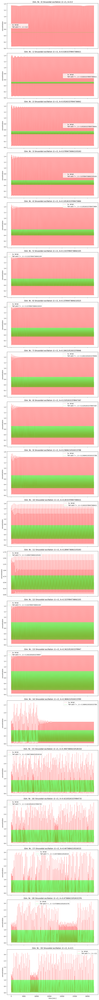

In [142]:
figure, axis = plt.subplots(stepsize, figsize=[10,stepsize*5])

for i in tqdm(range(stepsize)):
        axis[i].plot(all_t[i], x*all_N_ni[i], color="#FF0000", alpha=0.8, lw=0.5, label = f'{x}x  NF$\kappa$B')
        axis[i].plot(all_t[i], all_TNF[i], alpha=1, color="#03FF00", lw=0.5, label = f'TNF with T = , A = {Amp_arr[i]}')
        axis[i].set_title(rf'(Sim. Nr.: {i}) Sinusoidal oscillation: $\Omega$ =/1, A={Amp_arr[i]}')
        axis[i].legend();  
for ax in axis.flat:
    ax.set(xlabel='time [min.]', ylabel='concentration')
for ax in axis.flat:
    ax.label_outer()

    plt.tight_layout()

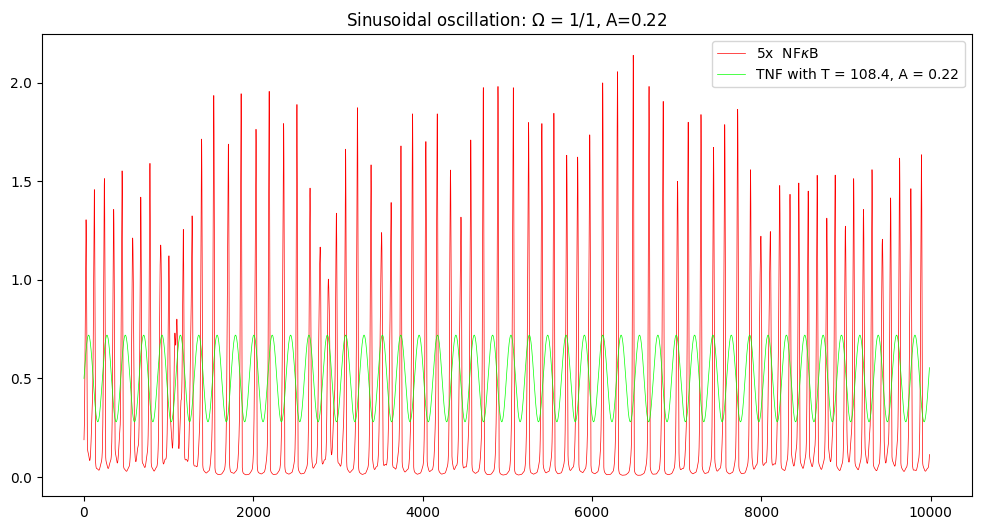

In [250]:
plt.figure(figsize=(12,6))
plt.plot(all_t[4][:100000], x*all_N_ni[4][:100000], color="#FF0000", alpha=1, lw=0.5, label = f'{x}x  NF$\kappa$B')
plt.plot(all_t[4][:100000], all_TNF[4][:100000], alpha=1, color="#03FF00", lw=0.5, label = f'TNF with T = {T_TNF2:.4}, A = {Amp_arr[i]}')
plt.title(rf'Sinusoidal oscillation: $\Omega$ = {omega}/1, A={Amp_arr[i]}')
plt.legend();  

In [79]:
plt.figure(figsize=(12,6))
plt.plot(all_t[0], x*all_N_ni[0], color="#FF0000", alpha=0.8, lw=0.5, label = f'{x}x  NF$\kappa$B')
plt.plot(all_t[0], all_TNF[0], alpha=1, color="#03FF00", lw=0.5, label = f'TNF with T = {T_TNF2:.4}, A = {Amp_arr[i]}')
plt.title(rf'Sinusoidal oscillation: $\Omega$ = {omega}/1, A={Amp_arr[i]}')
plt.legend();  

NameError: name 'all_t' is not defined

<Figure size 1200x600 with 0 Axes>

Text(0.5, 0.92, 'Simulating the NF-kB network')

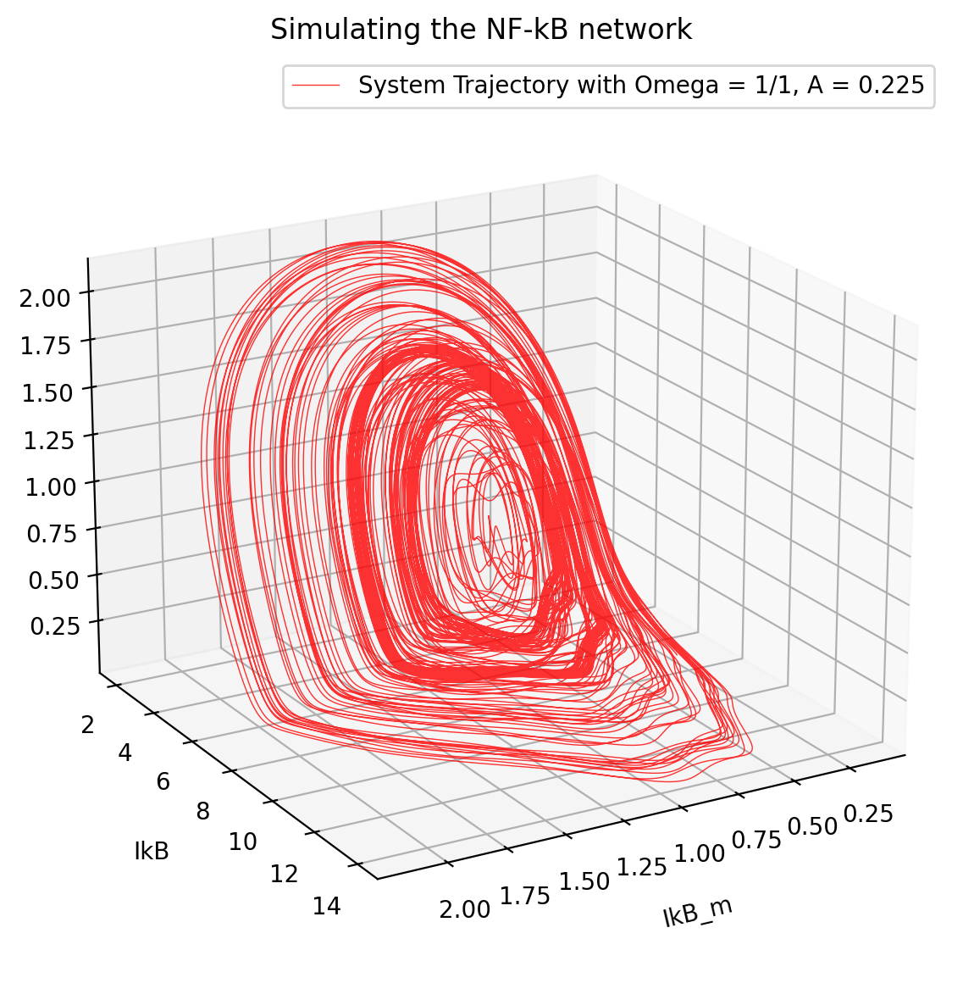

In [332]:
fig = plt.figure(figsize=(6, 6), dpi=200)
ax_3d = fig.add_subplot(111, projection='3d')  # Correct index for 3D plot
ax_3d.plot(all_Im[-1][30000:], all_I[-1][30000:], all_N_ni[-1][30000:] * 5, color="#FF0000", alpha=0.8, lw=0.5, label=f'System Trajectory with Omega = {omega}/1, A = {Amp_arr[-1]}')
ax_3d.set_xlabel(r'IkB_m', labelpad=10)
ax_3d.set_ylabel('IkB', labelpad=10)
# Adjust the z-label position
ax_3d.set_zlabel('5x NFkB', labelpad=10)  # Adjust labelpad as needed

# Adjusting the view angle
ax_3d.view_init(elev=20, azim=60)  # Adjust elevation and azimuth to improve visibility

ax_3d.set_title(f'3D Phase Space')
ax_3d.legend()


plt.tight_layout()
plt.title("Simulating the NF-kB network")

/var/folders/k7/f1crpym10dq1jlwf0j2n3h080000gn/T/ipykernel_20788/684443443.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(6, 6), dpi=200)


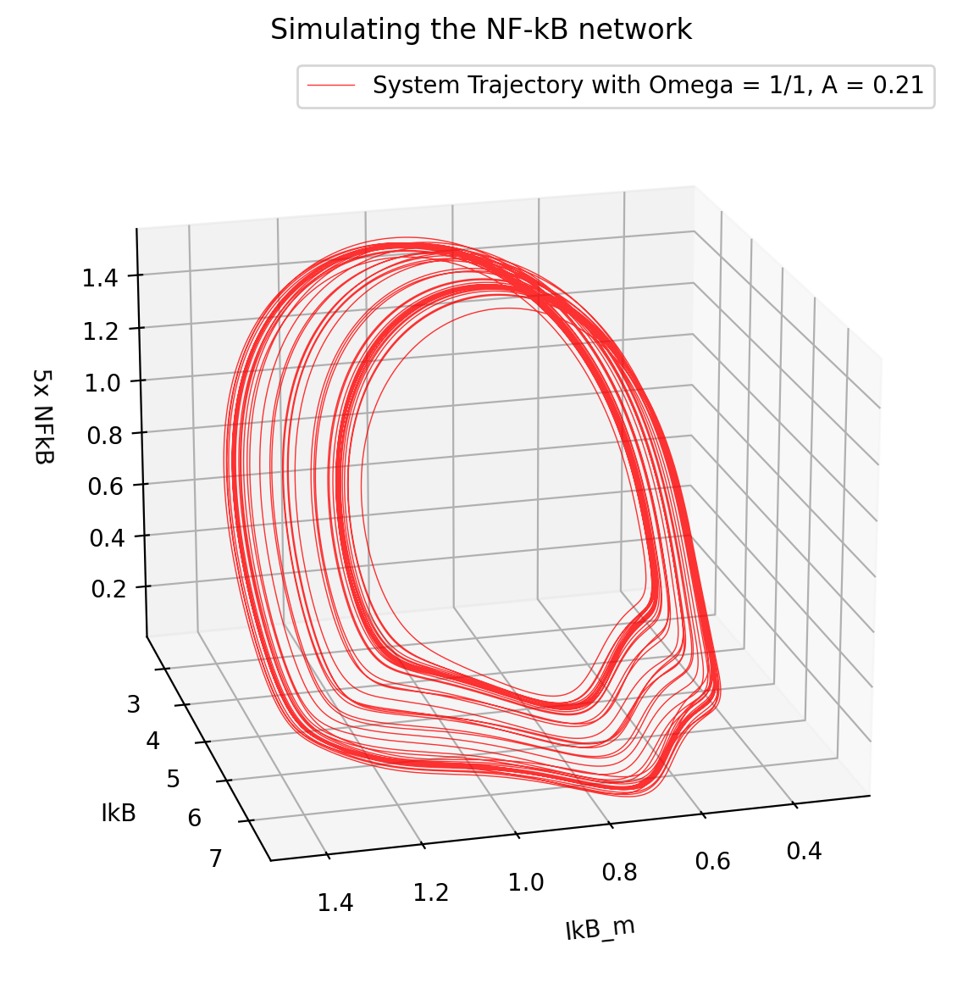

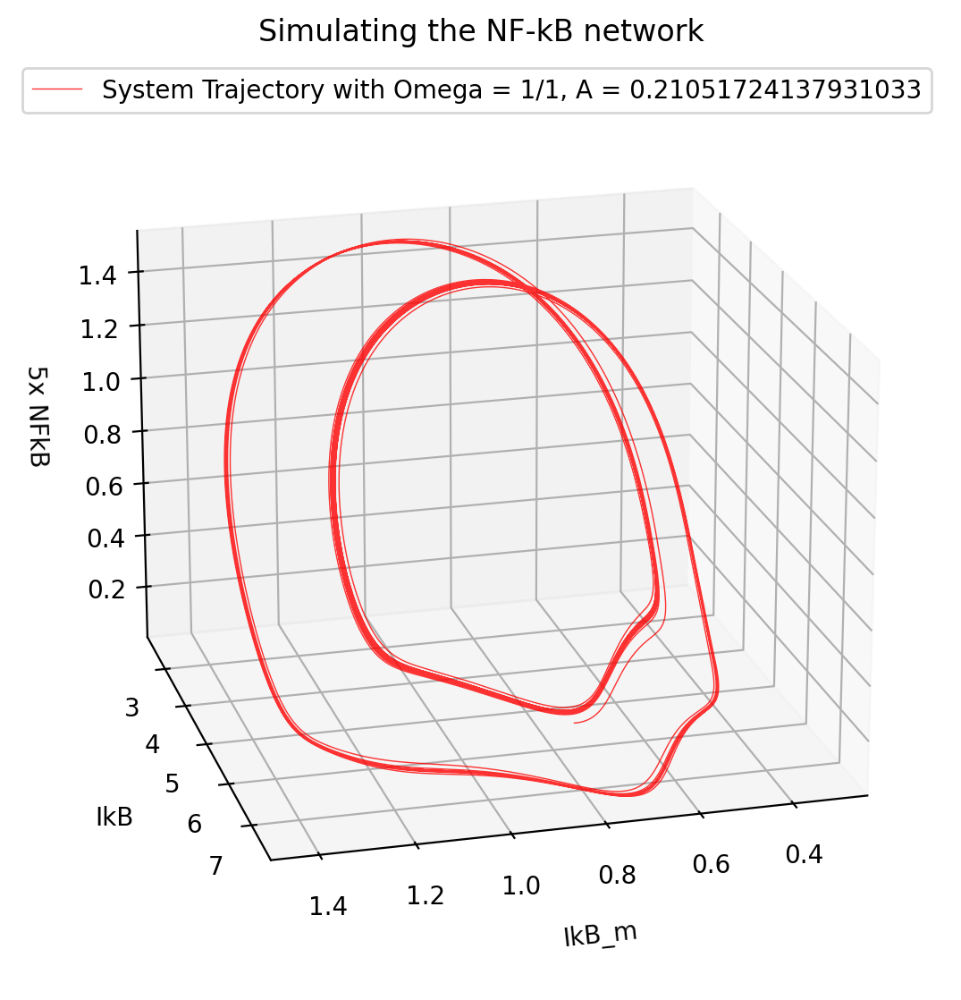

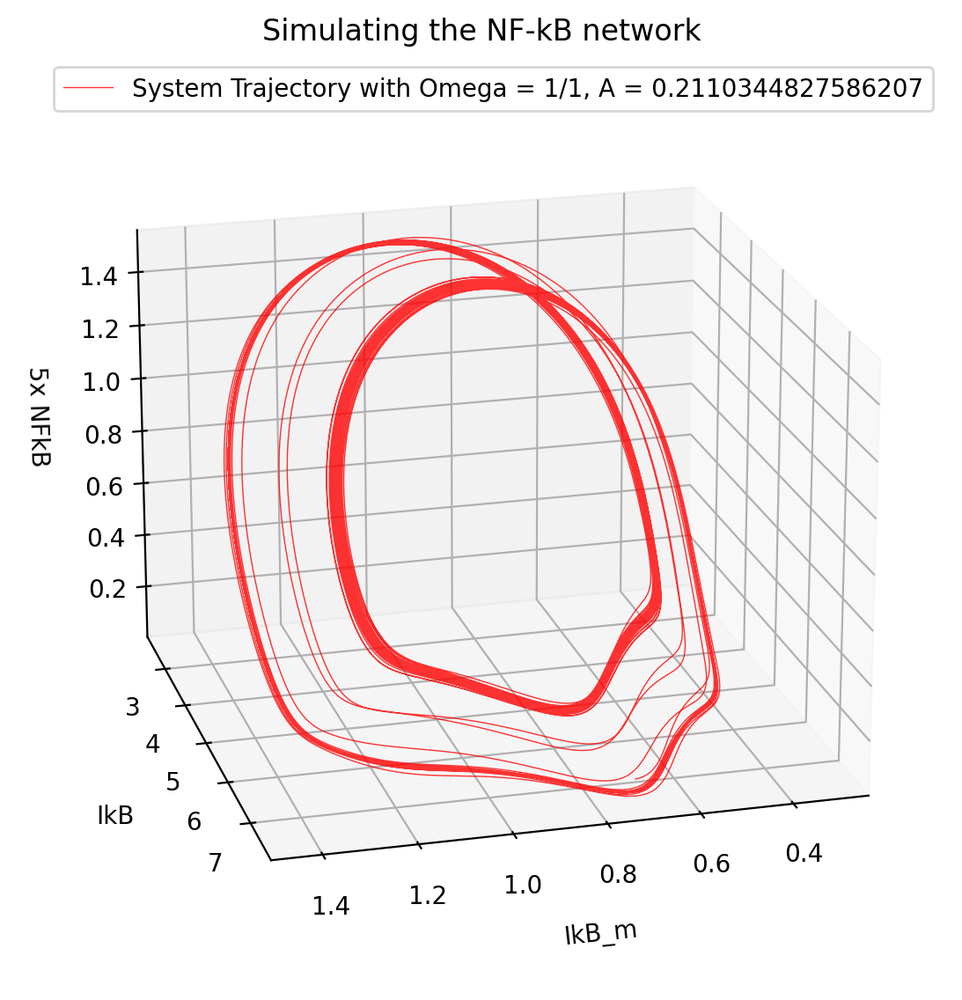

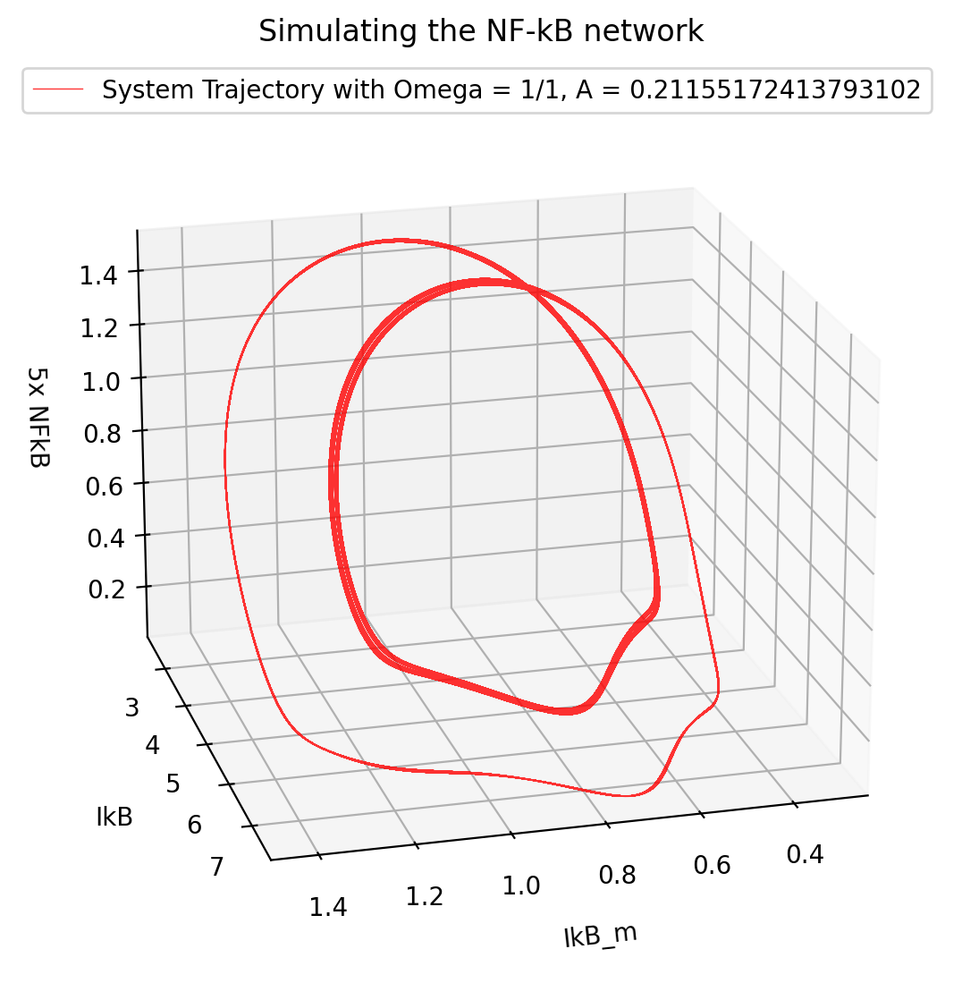

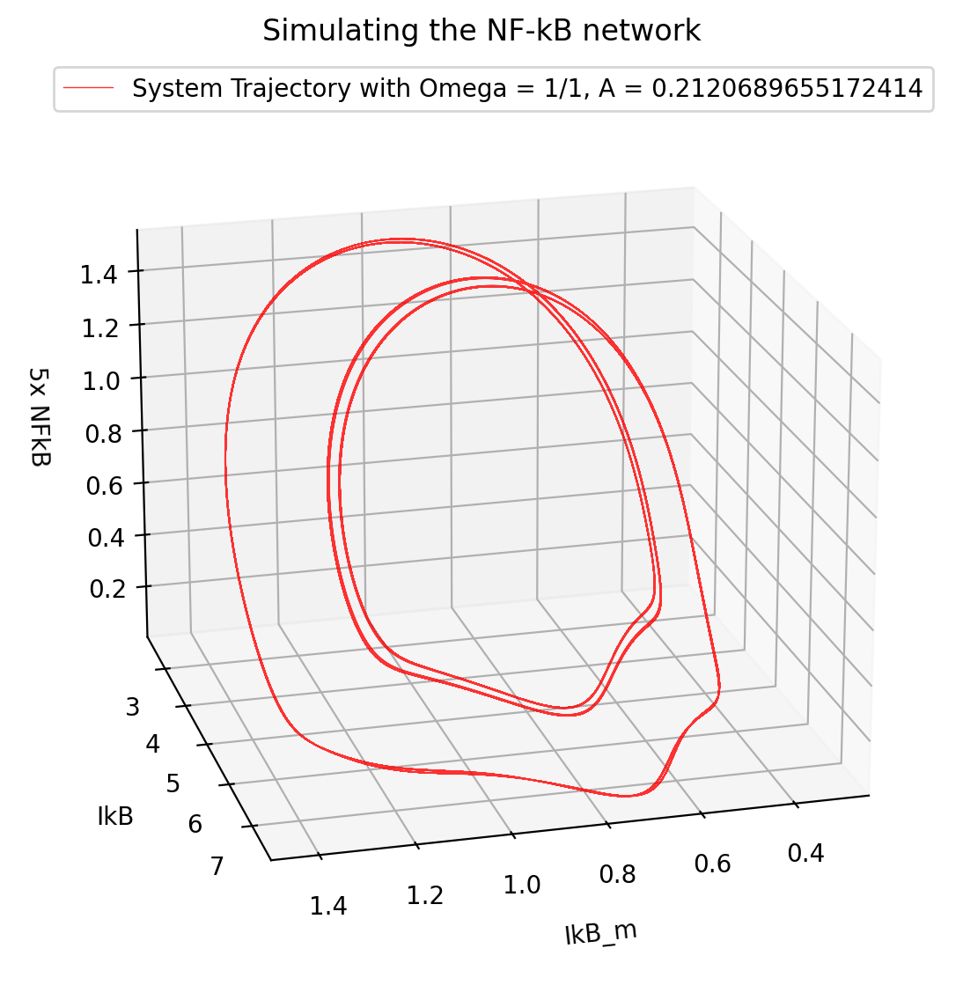

...

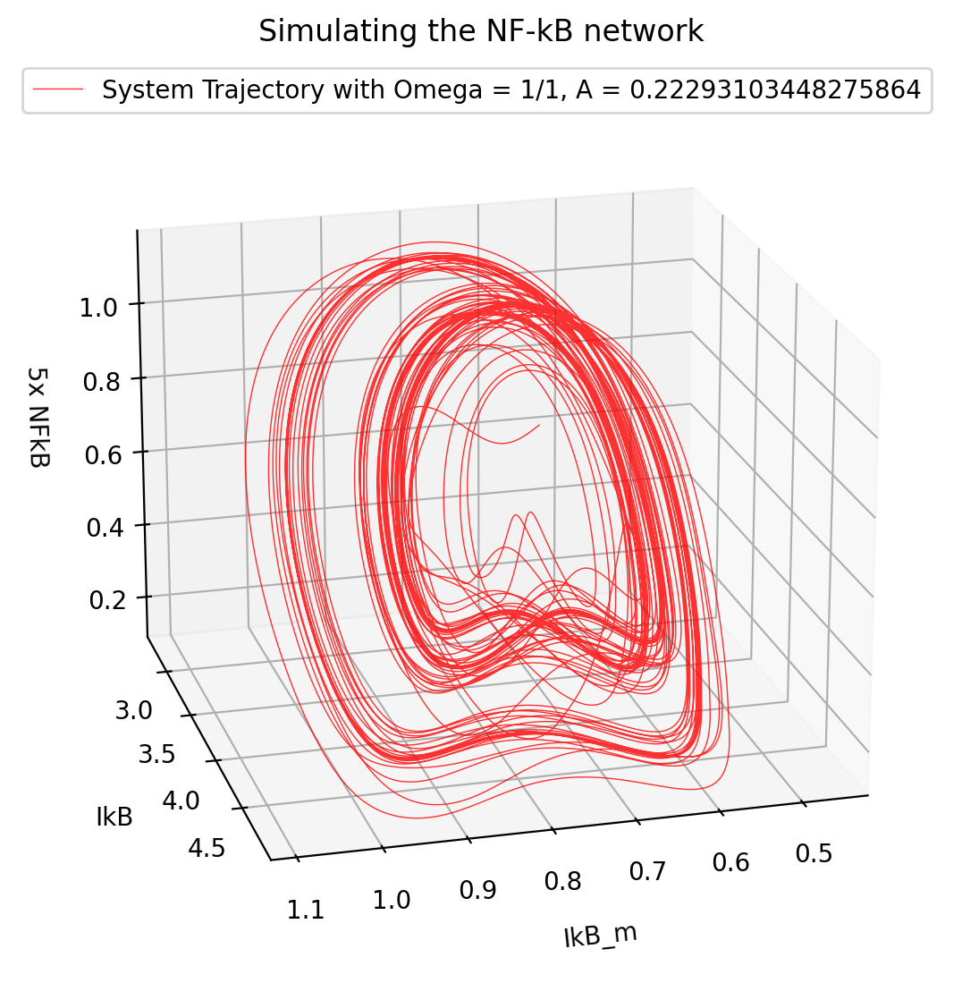

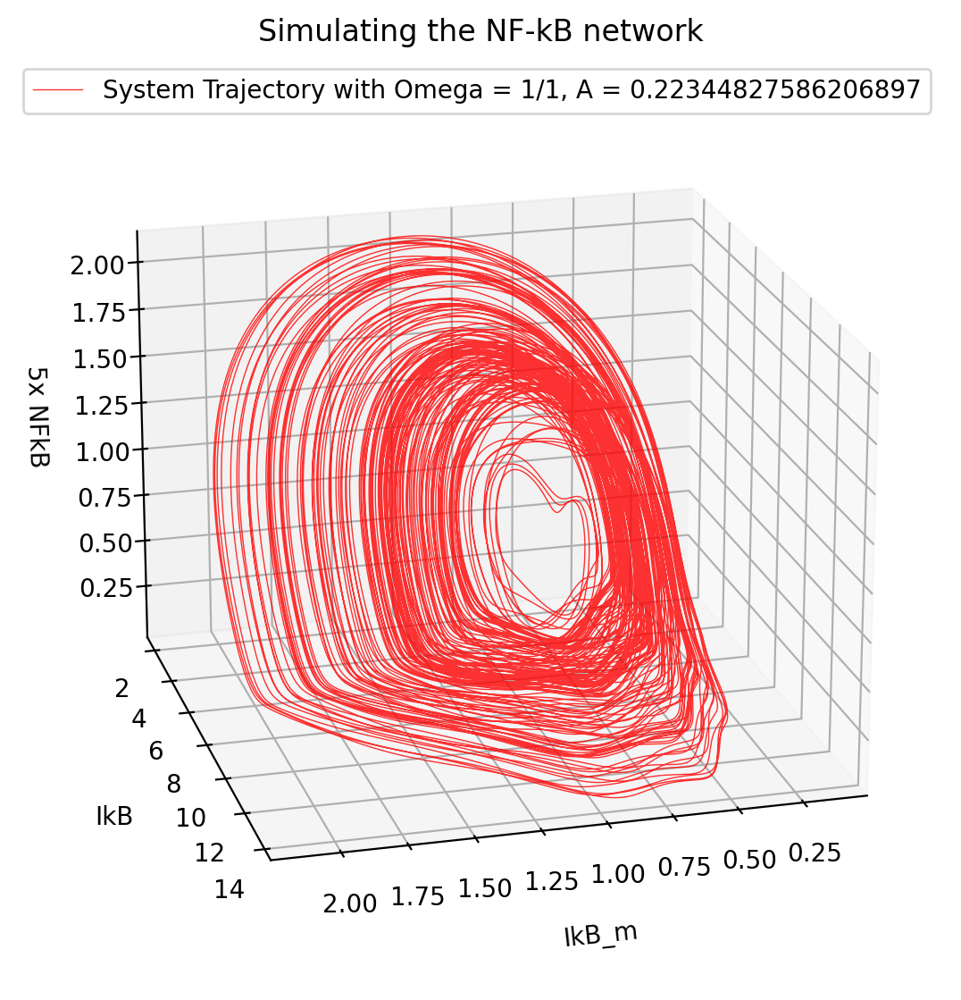

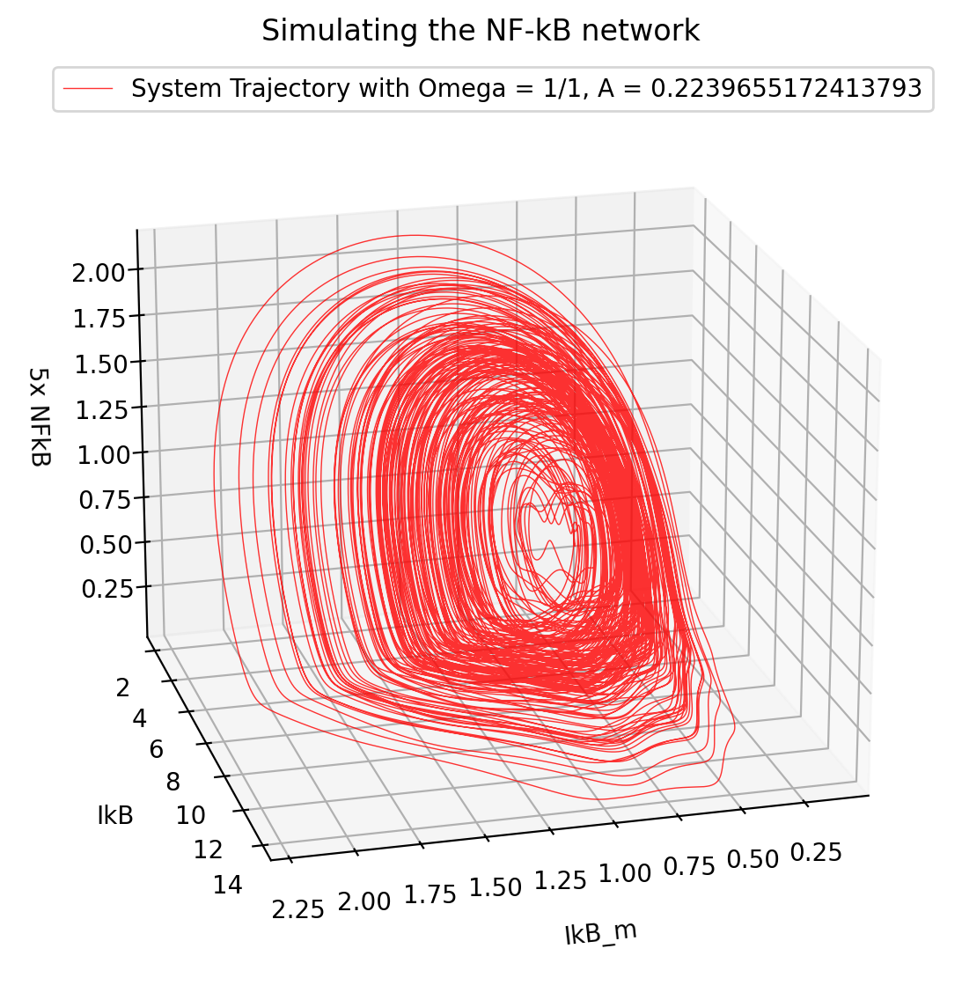

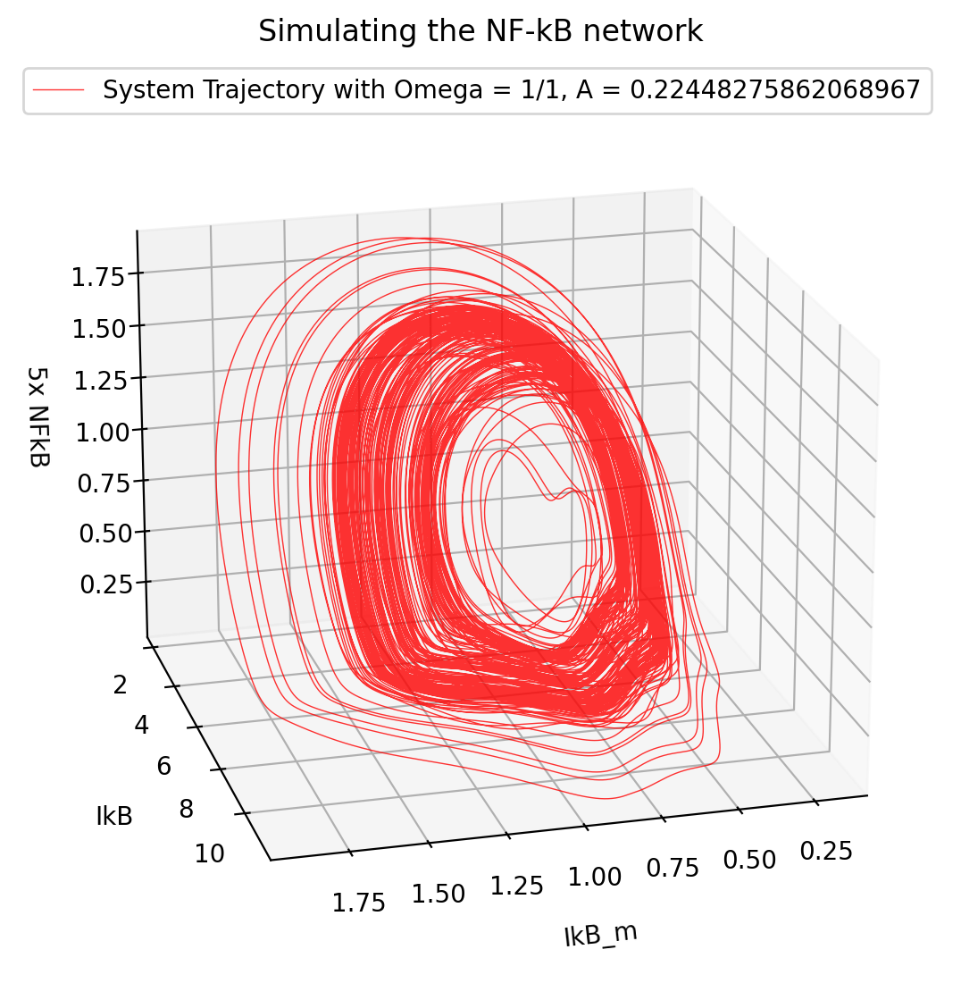

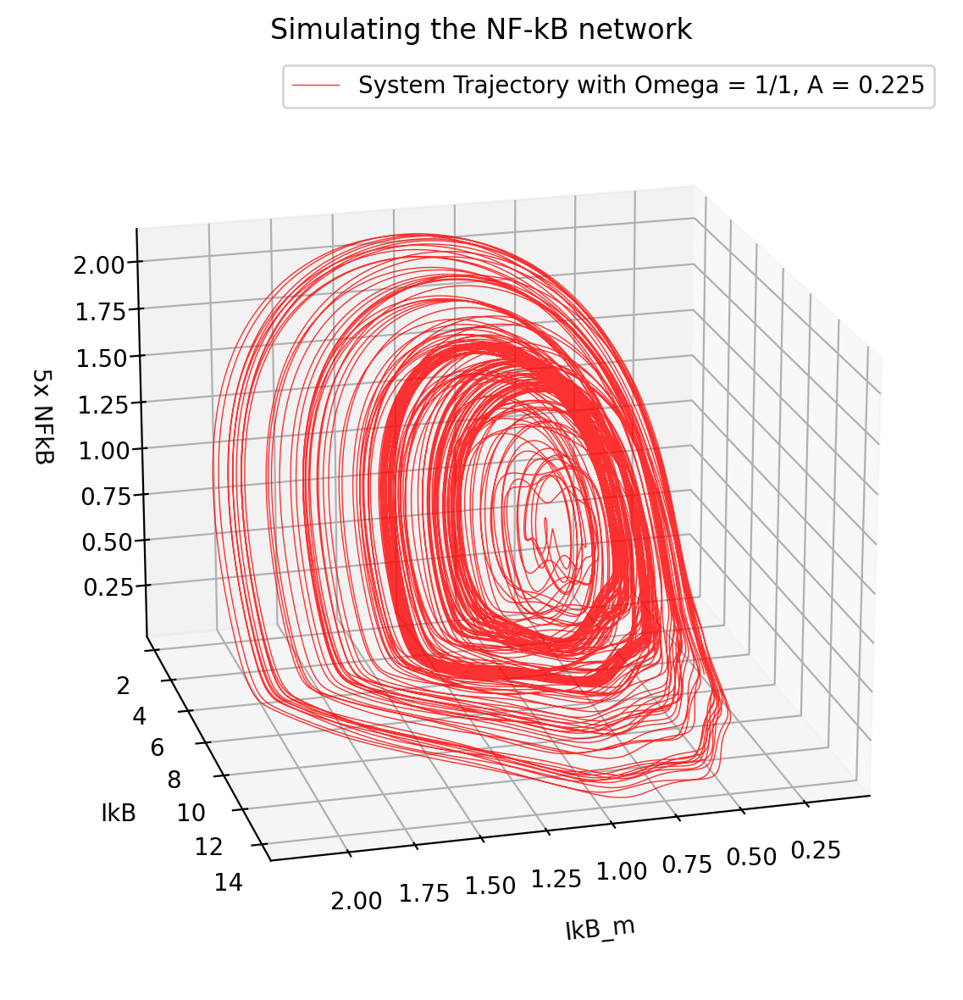

In [314]:
for i in range(stepsize):
    fig = plt.figure(figsize=(6, 6), dpi=200)
    ax_3d = fig.add_subplot(111, projection='3d')  # Correct index for 3D plot
    ax_3d.plot(all_Im[i][30000:], all_I[i][30000:], all_N_ni[i][30000:] * 5, color="#FF0000", alpha=0.8, lw=0.5, label=f'System Trajectory with Omega = {omega}/1, A = {Amp_arr[i]}')
    ax_3d.set_xlabel(r'IkB_m', labelpad=10)
    ax_3d.set_ylabel('IkB', labelpad=10)
    # Adjust the z-label position
    ax_3d.set_zlabel('5x NFkB', labelpad=10)  # Adjust labelpad as needed

    # Adjusting the view angle
    ax_3d.view_init(elev=20, azim=75)  # Adjust elevation and azimuth to improve visibility

    ax_3d.set_title(f'3D Phase Space')
    ax_3d.legend()


    plt.tight_layout()
    plt.title("Simulating the NF-kB network")